# Running a standard analysis

In [1]:
%load_ext autoreload
%autoreload 2

In [51]:
import napari
from pathlib import Path
import numpy as np
import skimage
from cellpose import models
from napari_steinpose.steinpose_widget import SteinposeWidget
from napari.utils import nbscreenshot

In [52]:
viewer =napari.Viewer()
widget = SteinposeWidget(viewer)
viewer.window.add_dock_widget(widget)

/Users/gw18g940/mambaforge/envs/mcd/lib/python3.9/site-packages/napari_tools_menu/__init__.py:194: FutureWarning: Public access to Window.qt_viewer is deprecated and will be removed in
v0.5.0. It is considered an "implementation detail" of the napari
application, not part of the napari viewer model. If your use case
requires access to qt_viewer, please open an issue to discuss.
  self.tools_menu = ToolsMenu(self, self.qt_viewer.viewer)


Here we present all the steps of a standard workflow including segmentation and analysis.

## Complete sequence

### 1. Load the plugin

Go to the plugins menu and choose the Steinpose plugin. You should see the plugin on the right of the window:

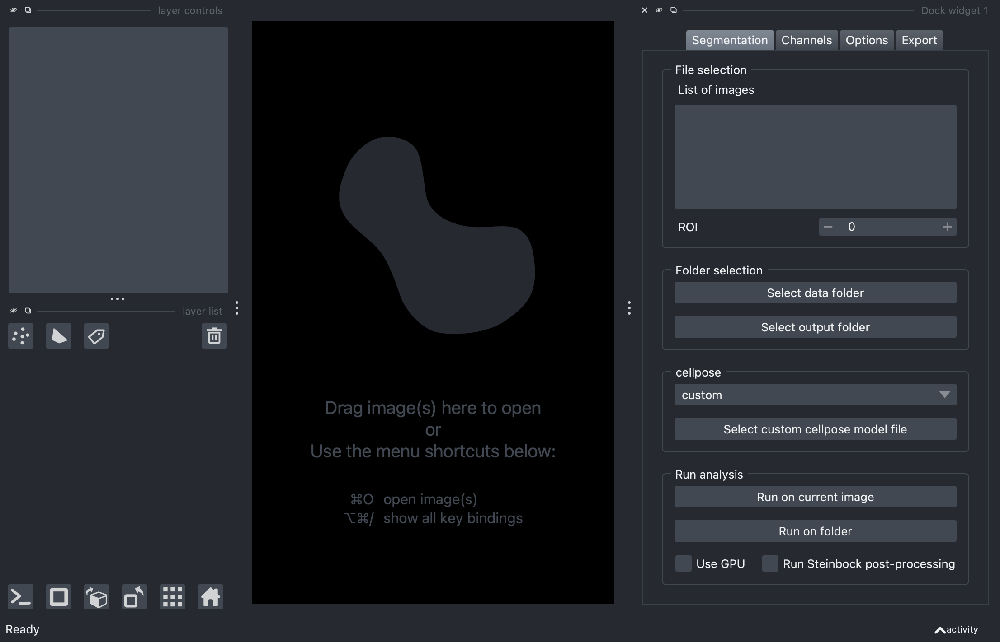

In [43]:
nbscreenshot(viewer)

### 2. Folder selection

Using the ```Select data folder``` button, select a folder containig your mcd file(s). Using the ```Select output folder```, select a folder where to store the output.

Once a data folder is selected, a list of mcd files appears in the ```List of images```. If you select one of these files, it will load the image in the viewer, one channel per layer. If your mcd file contains multiple acquisitions or ROIs you can browse through them using the ROI slider.

In [46]:
file_folder = Path('../mcd_data/')
widget.file_list.update_from_path(file_folder)
widget.file_list.setCurrentRow(0)

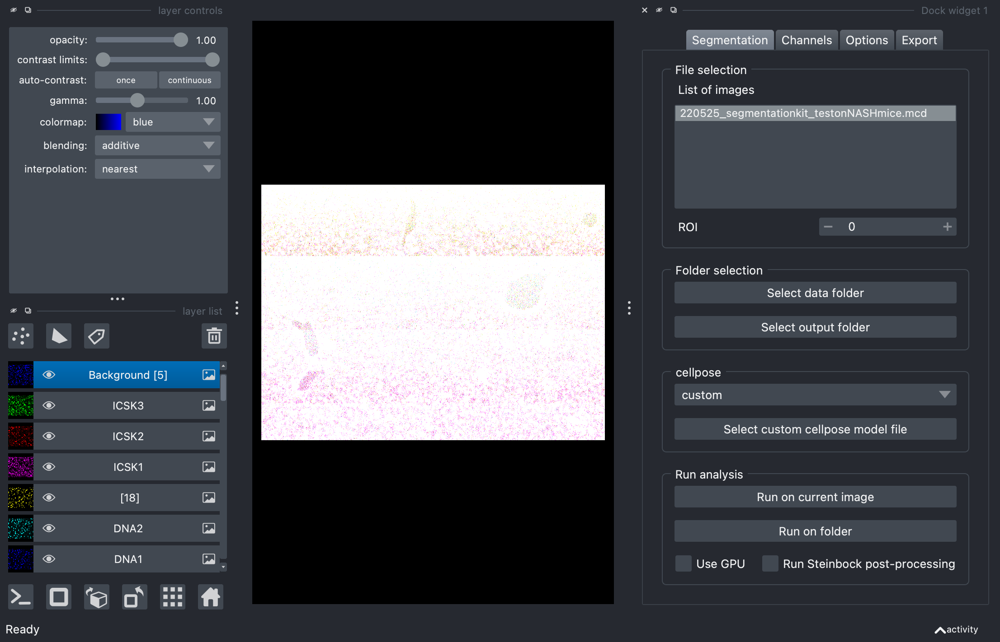

In [6]:
nbscreenshot(viewer)

### 3. Select channels for segmentation

For segmentation, you need to select as set of channels to merge in order to create an image showing the "main" objects to segment, usually cells. You can also define a second image with "helper" objects, usually nuclei. You can select those channels in the ```Channels``` tab. To select multiple channels, just hold the ```Ctrl``` button. As soon as you select channels for main and helper objects, new layers called ```merged_cell``` and ```merged_nuclei``` are added to the viewer, showing you the combination of those channels. How the combination is made, can be controlled via the ```Projection type``` selector.

To better visualize the merged images, you can turn off all other channels clicking on ```Show only merged channels```.

In [47]:
widget.tabs.setCurrentIndex(1)
cell_ch = ['ICSK1', 'ICSK2', 'ICSK3']
nucl_ch = ['DNA1','DNA2']
channel_list = [widget.qlist_merge_cell.item(x).text() for x in range(widget.qlist_merge_cell.count())]
[widget.qlist_merge_cell.item(channel_list.index(x)).setSelected(True) for x in cell_ch]
[widget.qlist_merge_nuclei.item(channel_list.index(x)).setSelected(True) for x in nucl_ch]

widget._on_change_merge_cell_selection()
widget._on_change_merge_nuclei_selection()
widget._on_show_only_merge()

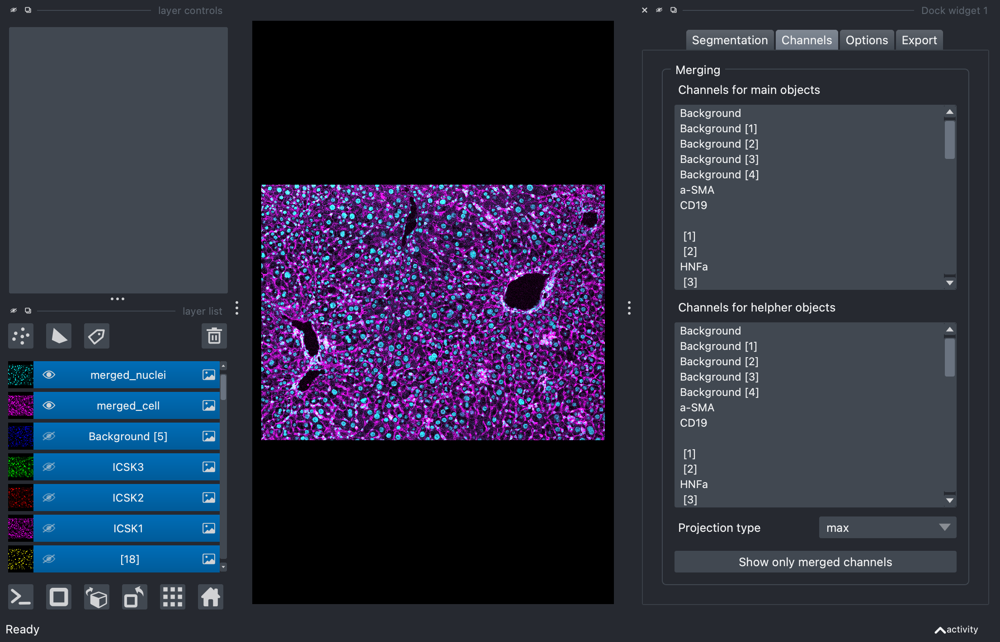

In [8]:
nbscreenshot(viewer)

### 4. Segmentation

To perform segmentation with cellpose, you need to adjust a few parameters:
1. In the ```cellpose``` section of the ```Segmentation``` tab, , choose the type of model that you want to use. If you select a ```custom``` model, you need to select the model file using the ```Select custom cellpose model file```. If you use one of the built-in models, you need to set an estimated diameter. Note:
    - It's not required to define a second image (```Channels for nuclei```), so the selection can remain empty
    - If you want to segment only nuclei in an image, **you need to select the channels to compose the merged nuclei image in the "main objects" list and the merged image is still going to be called ```marged_cell```**. 

In [48]:
widget.tabs.setCurrentIndex(0)
widget.qcbox_model_choice.setCurrentText('CP')
widget.spinbox_diameter.setValue(22)

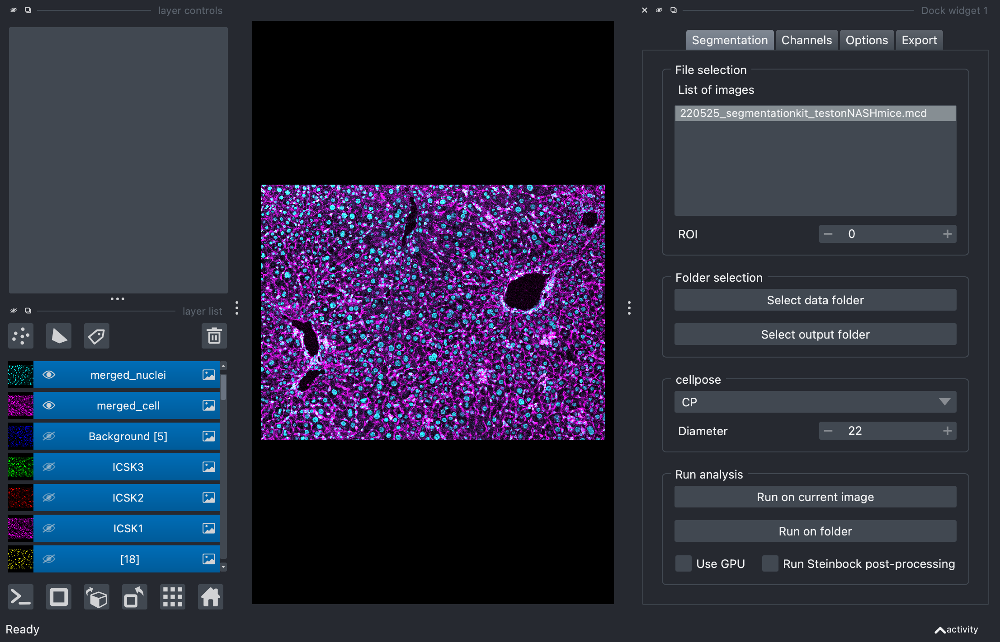

In [28]:
nbscreenshot(viewer)

2. In the ```Options``` tab, you can set additional options for segmentation:
    - Set cellpose flow and cell tthreshold: to recover more cells, use high flow threshold (around 1). To recover larger cells, use low cell probability threshold (around -6)
    - Select if you want to remove cells touching the image border
    - Select by how many pixels you want to expand the segmented objects

In [49]:
widget.tabs.setCurrentIndex(2)
widget.flow_threshold.setValue(1)
widget.cellprob_threshold.setValue(-6)

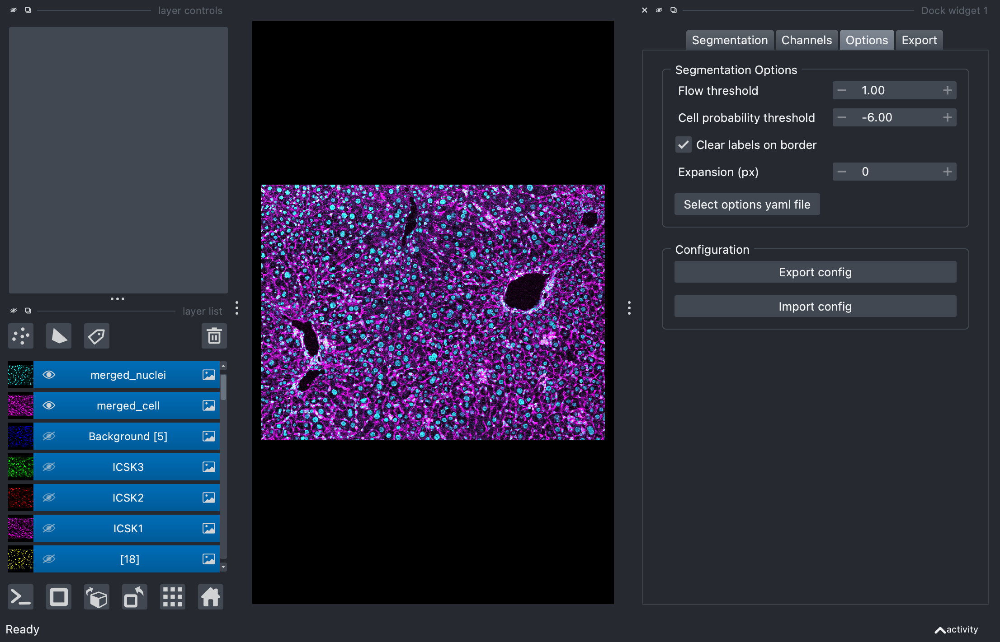

In [30]:
nbscreenshot(viewer)

### 5. Running the segmentation

Head back to the ```Segmentation tab```. Now you can finally run the segmentation. If GPU processing is setup, tick the ```Use GPU``` box. You can test the segmentation on a single image, by clicking on ```Run on current image```. This will run the segmentation only on the current ROI of the current image. Once processing is done, the segmentation is added as a ```mask```layer in the viewer.

If you want to run the analysis on **all ROIs of all images** click on ```Run on folder```. This will generate two folders in the output folder that you previously selected:
- ```masks``` contains all the segmentation images, one per ROI in uint16 format
- ```imgs_proj``` contaisn the merged images used for segmentation

In [50]:
widget.tabs.setCurrentIndex(0)
output_path = file_folder.joinpath('output')
output_path.mkdir(exist_ok=True)
widget.output_folder = output_path

In [ ]:
widget._on_click_run_on_current()

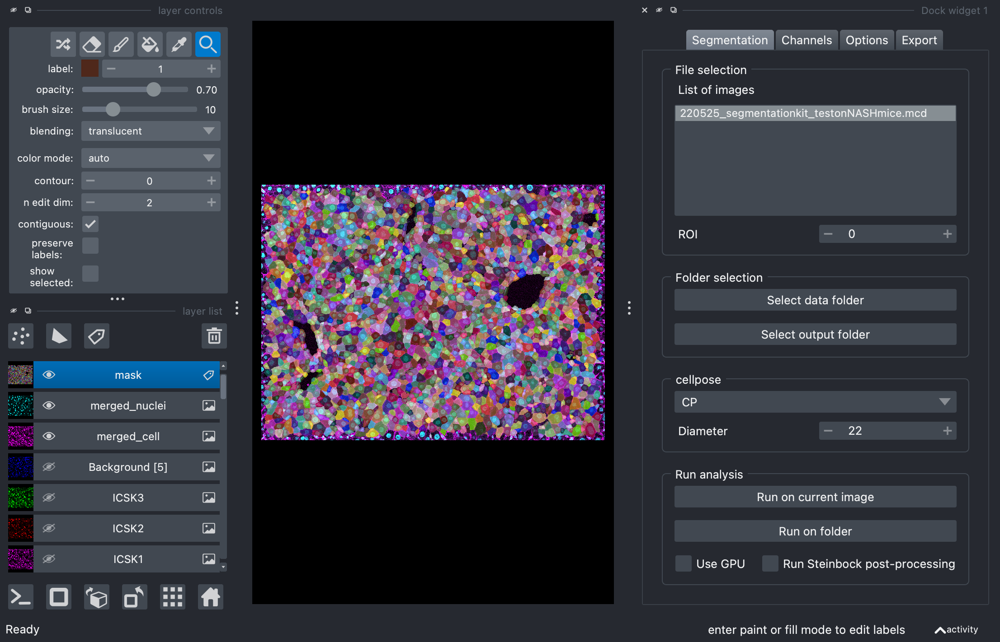

In [34]:
nbscreenshot(viewer)

In [36]:
widget._on_click_run_on_folder()

Running cellpose on 220525_segmentationkit_testonNASHmice.mcd acquisition 0
Running cellpose on 220525_segmentationkit_testonNASHmice.mcd acquisition 1
Running cellpose on 220525_segmentationkit_testonNASHmice.mcd acquisition 2
Running cellpose on 220525_segmentationkit_testonNASHmice.mcd acquisition 3
Running cellpose on 220525_segmentationkit_testonNASHmice.mcd acquisition 4
Running cellpose on 220525_segmentationkit_testonNASHmice.mcd acquisition 5


### 6. Post-processing

You can analyze the segmentation using the steinbock software. Three types of data extraction can be selected using tick boxes as visible in the ```Export``` tab:
- intensities: the intensity of each segmented objects is measured in all available channels and exported as a table. The statistic applied to summarize intensity (mean, max etc.) can be selected
- region properties: geometric properties of all segmented objects is measured and exported as as a table
- neighbourhood: the neighbours of each object are detected and stored in a table

Once options are set, you can click on ```Run Steinbock postproc```. This will generate:
- an ```img``` folder containing a tiff version of the mcd files. Note that with the ```Hot pixel filter``` options and threshold, you can perform hot pixel fitlering when exporting the images
- an ```intensities``` folder containing intensity tables (if selected)
- a ```regionprops``` folder containing region properties tables (if selected)
- a ```neighbors``` folder containing neighborhood tables (if selected)
- a ```panel.csv``` file
- an ```images.csv``` file

**Note that you can automatically perform this post-processing after segmentation by ticking the ```Run steinbock post-processing``` box in the ```Segmentation``` tab.**

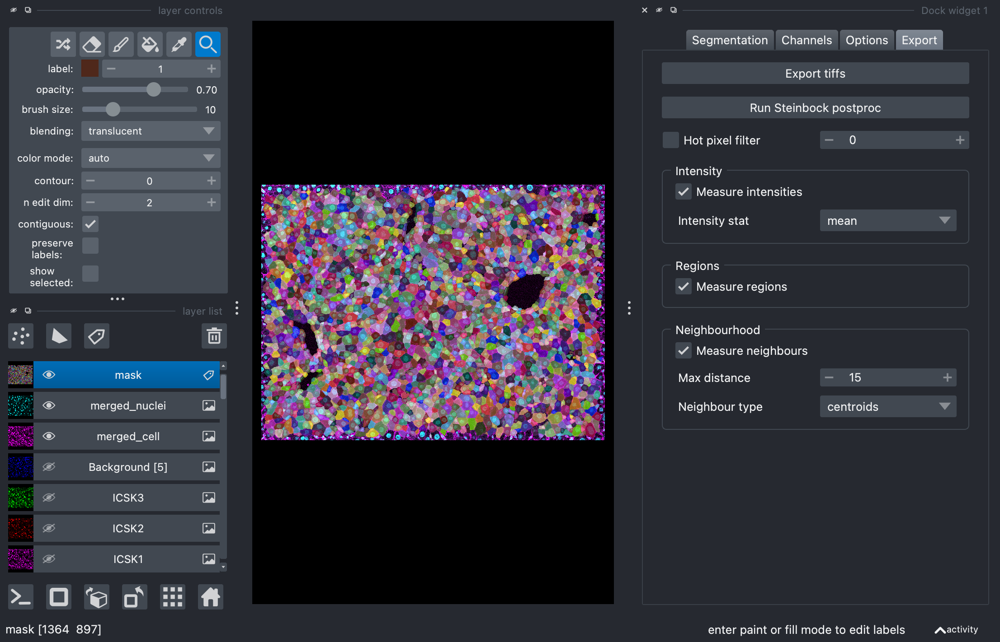

In [38]:
widget.tabs.setCurrentIndex(3)
nbscreenshot(viewer)

## Notes

### Reloading data

If you select a data folder and an output folder containing a previous segmentation, when you select an image, this will display the merged images as well as the masks automatically. 

### Exporting a config file

To avoid having to setup the same options repeatedly, you can export a set of seleted options as a small ```config.yml``` file in the output folder. This will typically contain the selected channels for merging, the type of model, diameter etc. First, set all options, then head to the ```Options``` tab and click on ```Export config```.

In order to re-use this config file:
1. Copy the ```config.yml``` file in a new empty folder
2. Select the data folder and select an image to display
3. Select the new folder containing the copied ```config.yml``` file as output folder and then click on ```Import config``` in the ```Options tab```. This will update a series of options. The reason why an image needs to be loaded in the viewer, is that the channel names are needed to re-use the same combination of channels to merge. **Hence, you cannot re-use the configuration file, if you use an image with a different set of channels**.